# 2021-2 텍스트마이닝 기말 프로젝트

# import packages

In [332]:
import requests
import time
import re
import pandas as pd
import pprint
import pycrfsuite
import eli5
import numpy as np
import matplotlib.pyplot as plt
import math
import seaborn as sns
import site; site.getsitepackages()
from bs4 import BeautifulSoup
from tensorflow.keras.layers import Embedding, Dense, LSTM
from tensorflow.keras.models import Sequential
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier

from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from collections import defaultdict
from sklearn_crfsuite import CRF 
from sklearn.model_selection import cross_val_predict
from sklearn_crfsuite .metrics import flat_classification_report 
from nltk.probability import FreqDist
from pycrfsuite_spacing import TemplateGenerator
from pycrfsuite_spacing import CharacterFeatureTransformer
from pycrfsuite_spacing import sent_to_xy
from konlpy.tag import Kkma as kkm

# Web Scraping

In [333]:
# 참고 사이트 https://yeo0.github.io/data/2018/09/24/5.-%EB%A1%9C%EA%B7%B8%EC%9D%B8%EC%9D%B4-%ED%95%84%EC%9A%94%ED%95%9C-%EC%82%AC%EC%9D%B4%ED%8A%B8%EC%97%90%EC%84%9C%EC%9D%98-%ED%81%AC%EB%A1%A4%EB%A7%81/
# 참고 사이트 2 https://hashcode.co.kr/questions/9084/%EC%9E%A1%ED%94%8C%EB%9E%98%EB%8B%9B-%EB%A1%9C%EA%B7%B8%EC%9D%B8-%ED%9B%84-%EC%8A%A4%ED%81%AC%EB%A0%88%EC%9D%B4%ED%95%91-%EB%AC%B8%EC%9D%98%EB%93%9C%EB%A6%BD%EB%8B%88%EB%8B%A4-%E3%85%9C%E3%85%9C

# 로그인 할 url
url = "https://www.jobplanet.co.kr/users/sign_in?_nav=gb"
user_agent = 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/78.0.3904.97 Safari/537.36'
headers = {'Content-type': 'application/json', 'Accept': 'text/plain', 'User-Agent':user_agent}
login_data = {'user':{'email':'hsmy31@hanyang.ac.kr', 'password':'rhkwpgksmswnd!', 'remember_me':'true'}}
session = requests.session()

# 로그인 실행
login_response = session.post(url, json = login_data, headers = headers)

reviews = []

In [334]:
#전체 리뷰 추출

def all_reviews(code):
    url = "https://www.jobplanet.co.kr/reviews?&industry_id=" + str(code)
    response =  session.get(url)
    soup = BeautifulSoup(response.text, 'html.parser')
    num = soup.find('span', class_='num') # 리뷰 개수 확인
    num = int(num.get_text().strip())
    import math, random
    pages = math.ceil(num / 10)
    reviews = {}
    for i in range(pages+1):
        time.sleep(1)
        url = "https://www.jobplanet.co.kr/reviews?&industry_id=" + str(code) + "&page="+ str(i)
        response =  session.get(url)
        soup = BeautifulSoup(response.text, 'html.parser')
        label = soup.find_all('h2', class_="us_label") # 한 줄 리뷰 추출
        # 추출한 리뷰에서 태그를 제외한 텍스트만 추출하여 labels 리스트에 저장
        labels = [label.get_text().strip() for label in label[:]]
        star = soup.find_all('div', class_="star_score") # 별점이 포함된 div 추출
        # 추출한 div에서 별점을 나타내는 width 속성의 숫자로 된 부분을 stars 리스트에 저장
        stars = re.findall('[0-9]+[.]+[0-9]', str(star))
        # reviews 딕셔너리에 '리뷰: 별점' 형식으로 추가
        for j in range(len(labels)):
            reviews[labels[j][5:-1]] = stars[j].replace('.0','')
    return reviews

In [335]:
#전체 리뷰 및 별점 딕셔너리화
codes = ['1001', '900', '704', '1004']
reviews={}

for i in range(0,len(codes)):
    reviews.update(dict(all_reviews(codes[i])))

In [410]:
len(reviews)

2558

In [411]:
# 리스트 형식으로 text와 score 각각 저장
text_all=list(reviews.keys())
score_all=list(reviews.values())

In [412]:
# 점수별 리뷰 수 분포
score_cnt = {} # 
for sc in score_all:
    sc_int = int(sc)
    if sc_int in score_cnt:
        score_cnt[sc_int] += 1
    else:
        score_cnt[sc_int] = 1

In [413]:
score_sort = sorted(score_cnt.items(), key=lambda item: item[0], reverse=True)

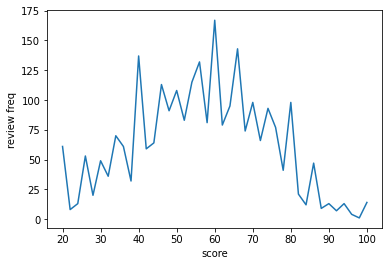

In [414]:
x=[]
y=[]
for i in range(len(score_sort)):
    x.append(score_sort[i][0])
    y.append(score_sort[i][1])
plt.plot(x, y)
plt.xlabel("score")
plt.ylabel("review freq")
plt.show()

In [415]:
# 전체 리뷰의 평균값 구하기
sum=0
for i in range(len(score_all)):
    sum+=int(score_all[i])
avr_all=sum/len(score_all)
print("score 평균값: ", round(avr_all,3))

score 평균값:  56.196


# 긍정어/부정어사전 만들기

In [416]:
#공통/ 업종별 불용어(자주 나오지만 문서 전체에 관련되어 있어 성능 체크에 의미가 없는 단어들) 선언
stopwords=['있음','기업', '업무', '회사', '직장','분위기','사람','직원','근무']

In [417]:
#긍/부정 리뷰별 빈출단어 추출 및 사전화
#검색 성능을 높이기 위해 문장을 제일 잘게 쪼개는 kkma 사용
kkm=kkm()
text_kkm=[]
#형태소 분석 및 문장별 점수 매칭
for i in range(len(text_all)):
    text_kkm.append(kkm.nouns(text_all[i]))
    text_kkm[i].append(score_all[i])

In [418]:
pos_kkm=[]
morphs_kkm=[]
dic_stopwords=stopwords
#연관이 낮아 보이는 형태소와 1글자 음절, 불용어를 제외한 체언, 용언, 관형사, 부사만 뽑아내기
for i in range(len(text_all)):
    pos_kkm.append(kkm.pos(text_all[i]))
dic_kkm=[]
for i in range(len(pos_kkm)):
    dic_kkm.append([])
    for j in range(len(pos_kkm[i])):
        if pos_kkm[i][j][0] not in dic_stopwords:
            if pos_kkm[i][j][1].startswith('N') or pos_kkm[i][j][1].startswith('V')or pos_kkm[i][j][1].startswith('M'):
                dic_kkm[i].append(pos_kkm[i][j][0])
    dic_kkm[i].append(int(score_all[i]))

In [419]:
# 긍/부정 빈도수 체크하여 상위 100개를 사전으로 저장
dic_text_pos=[]
dic_text_neg=[]  
for i in range(len(dic_kkm)):
    for j in range(0, len(dic_kkm[i])):
        if type(dic_kkm[i][j]) != int:
            if len(dic_kkm[i][j])>1:
                if float(dic_kkm[i][ -1]) > avr_all:
                    dic_text_pos.append(dic_kkm[i][j])
                else:
                    dic_text_neg.append(dic_kkm[i][j])

fdist1=FreqDist(dic_text_pos)
dic_text_pos=fdist1.most_common(100)

fdist1=FreqDist(dic_text_neg)
dic_text_neg=fdist1.most_common(100)

In [420]:
dic_text_pos1=[]
dic_text_neg1=[]

for i in range(len(dic_text_pos)):
    dic_text_pos1.append(dic_text_pos[i][0])
    
for i in range(len(dic_text_neg)):
    dic_text_neg1.append(dic_text_neg[i][0])

print(dic_text_pos1)
print(dic_text_neg1)

['일하', '다니', '경험', '다양', '문화', '기관', '배우', '복지', '생각', '편하', '환경', '성장', '연봉', '가지', '추천', '대하', '많이', '안정적', '공공', '공무원', '아니', '조직', '가능', '계약', '최고', '급여', '발전', '자유', '대우', '공기업', '괜찮', '나쁘', '업계', '매우', '시간', '여러', '강도', '하지만', '힘들', '보장', '사업', '수평적', '개발', '경력', '부서', '따르', '없이', '본인', '장점', '금융', '자기', '커리어', '보수적', '생활', '너무', '비하', '신입', '투자', '위하', '은행', '다르', '그냥', '함께', '노력', '수준', '전반적', '만족', '사회', '보이', '정도', '만큼', '월급', '기회', '능력', '성과', '다른', '인턴', '체계', '하나', '느끼', '가능성', '개인', '정규직', '외국계', '야근', '지원', '관련', '다만', '지역', '규모', '때문', '모두', '빠르', '사내', '운영', '눈치', '느낌', '해보', '위치', '그러']
['다니', '일하', '배우', '추천', '생각', '문화', '복지', '다양', '힘들', '기관', '너무', '연봉', '아니', '경력', '많이', '경험', '신입', '사무실', '대하', '급여', '자유', '체계', '그냥', '성장', '괜찮', '발전', '나쁘', '모르', '환경', '못하', '개인', '시간', '매우', '대표', '야근', '다르', '편하', '위하', '따르', '가지', '업계', '안정적', '바뀌', '사업', '가능', '보수적', '운영', '보험', '입사', '금융', '별로', '이상', '퇴사', '최악', '공공', '본인', '계약', '조직', '회계', '하나', '오래', '대우', '은행', '장점', 

# 데이터 전처리

In [421]:
sent_num=0
text_sent=[]

for i in range(len(text_all)):
    text_pos=kkm.pos(text_all[i])
    sent_num+=1
    for t in text_pos:
        n=list(t)
        n.insert(0, "Sentence: {}".format(sent_num))
        if float(score_all[(sent_num-1)]) > avr_all:
            n.insert(3, '100')
        else: 
            n.insert(3, '0')        
        text_sent.append(n)

In [422]:
len(text_sent)

63552

In [423]:
# 불용어 처리 전 token 빈도 수 확인
words=[]
for t in text_sent :
    words.append(t[1])

In [424]:
# 단어 사전 만들기 (key : value = word : 빈도 수)
words_dict = {} # 
for word in words:
    if word in words_dict:
        words_dict[word] += 1
    else:
        words_dict[word] = 1

In [425]:
sort_dict = sorted(words_dict.items(), key=lambda x: x[1], reverse=True)    

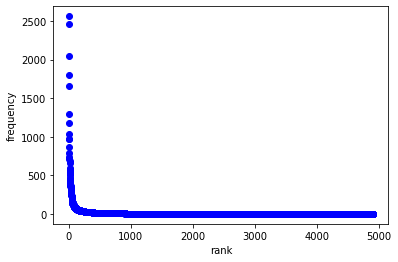

In [426]:
rank=0

for k, v in sort_dict:
    rank+=1
    plt.plot(rank, words_dict[k], 'bo')
plt.xlabel('rank')
plt.ylabel('frequency')
plt.show()

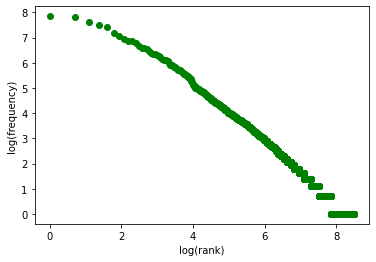

In [427]:
rank=0
for k, v in sort_dict:
    rank+=1
    plt.plot(math.log(rank), math.log(v), 'go')
plt.xlabel('log(rank)')
plt.ylabel('log(frequency)')
plt.show()

In [428]:
text_del_SW = [] # POS(조사, 특수문자, 접사) 제거

for t in text_sent : 
    if ( (t[2][0] !='E') & (t[2][0] !='J') & (t[2][0] !='S') ):
        text_del_SW.append(t)

In [429]:
# (수동)불용어 사전 만들기
stopwords2=['하', '수', '있', '이','것', '되', '등', '적', '들', '성', '일', '보', '롭', '주']
text_del_SW2 = []
for t in text_del_SW: 
    if t[1] not in stopwords2:
        text_del_SW2.append(t)

In [430]:
len(text_sent) # 불용어 처리 전 token 수

63552

In [431]:
len(text_del_SW2) # 불용어 처리 후 token 수

31265

In [432]:
words=[]
for t in text_del_SW2 :
    words.append(t[1])
        

In [433]:
# 단어 사전 만들기 (key : value = word : 빈도 수)
words_dict = {} # 
for word in words:
    if word in words_dict:
        words_dict[word] += 1
    else:
        words_dict[word] = 1

In [434]:
pprint.pprint(sorted(words_dict.items(), key=lambda item: item[1], reverse=True)[:10])

[('회사', 788),
 ('좋', 712),
 ('곳', 548),
 ('업무', 395),
 ('없', 373),
 ('사람', 365),
 ('않', 324),
 ('많', 316),
 ('일하', 266),
 ('분위기', 257)]


# CRF model 적용해보기

In [435]:
data = pd.DataFrame(text_del_SW2) # data를 pandas로 변환

In [436]:
data.columns = ['Sentence #', 'Word', 'POS', 'score']

In [437]:
data.head(10)

,Sentence #,Word,POS,score
0,Sentence: 1,대체적,NNG,100
1,Sentence: 1,근무,NNG,100
2,Sentence: 1,환경,NNG,100
3,Sentence: 1,좋,VA,100
4,Sentence: 1,부서,NNG,100
5,Sentence: 1,따르,VV,100
6,Sentence: 1,다르,VV,100
7,Sentence: 1,업무량,NNG,100
8,Sentence: 1,몰리,VV,100
9,Sentence: 1,시,NNG,100


In [438]:
data.tail(10)

,Sentence #,Word,POS,score
31255,Sentence: 2558,무관,NNG,0
31256,Sentence: 2558,잡일,NNG,0
31257,Sentence: 2558,완벽,NNG,0
31258,Sentence: 2558,수행,NNG,0
31259,Sentence: 2558,꼰대,NNG,0
31260,Sentence: 2558,문화,NNG,0
31261,Sentence: 2558,견디,VV,0
31262,Sentence: 2558,사람,NNG,0
31263,Sentence: 2558,적합,NNG,0
31264,Sentence: 2558,곳,NNG,0


In [439]:
data.isnull().sum() # 비어있는 값 확인 결과: 없음

Sentence #    0
Word          0
POS           0
score         0
dtype: int64

In [440]:
words = list(set(data["Word"].values))
n_words = len(words) # 고유한 단어의 수: 4668개
n_words

4696

In [441]:
# 데이터에서 문장을 원하는 형태로 포매팅하여 추출하는 클래스
# Word, POS -> data를 여러 함수로 씌워서 봄. 
class SentenceGetter(object):
    
    def __init__(self, data):
        self.n_sent = 1
        self.data = data
        self.empty = False
        # for문 사용법 보기. lambda: 일종의 함수(적용하는), data에 다음과 같은 기능 적용
        agg_func = lambda s: [(w, p, s) for w, p, s in zip(s["Word"].values.tolist(),
                                                            s["POS"].values.tolist(),
                                                            s["score"].values.tolist())]
        # sentence 단위로 grouped
        self.grouped = self.data.groupby("Sentence #").apply(agg_func)
        # 그룹화된 데이터를 다시 sentences로 저장
        self.sentences = [s for s in self.grouped]
        print(self.grouped)
        self.sentences
    
    # get_next: 다음 문장 처리
    def get_next(self):
        try:
            s = self.grouped["Sentence: {}".format(self.n_sent)]
            self.n_sent += 1
            return s
        except:
            return None


In [442]:
# 전체 문장 추출
getter = SentenceGetter(data)

Sentence #
Sentence: 1       [(대체적, NNG, 100), (근무, NNG, 100), (환경, NNG, 10...
Sentence: 10      [(노동법, NNG, 100), (제대로, MAG, 100), (지키, VV, 10...
Sentence: 100     [(공공, NNG, 100), (기관, NNG, 100), (경찰관, NNG, 10...
Sentence: 1000    [(스마트, NNP, 100), (동료, NNG, 100), (일하, VV, 100...
Sentence: 1001    [(너무, MAG, 100), (좋, VA, 100), (일도, NNG, 100),...
                                        ...                        
Sentence: 995     [(커리어, NNG, 100), (도움, NNG, 100), (업무, NNG, 10...
Sentence: 996     [(본인, NNG, 100), (역량, NNG, 100), (따르, VV, 100)...
Sentence: 997     [(보험, NNG, 100), (비교, NNG, 100), (견적, NNG, 100...
Sentence: 998     [(칼, NNG, 100), (퇴, NNG, 100), (가능, NNG, 100),...
Sentence: 999     [(전전, NNG, 100), (정부, NNG, 100), (출연, NNG, 100...
Length: 2558, dtype: object


In [443]:
# 문장 하나
sent = getter.get_next()

In [444]:
# 추출한 문장 확인(적용 결과)
print(sent)

[('대체적', 'NNG', '100'), ('근무', 'NNG', '100'), ('환경', 'NNG', '100'), ('좋', 'VA', '100'), ('부서', 'NNG', '100'), ('따르', 'VV', '100'), ('다르', 'VV', '100'), ('업무량', 'NNG', '100'), ('몰리', 'VV', '100'), ('시', 'NNG', '100'), ('야근', 'NNG', '100'), ('필요', 'NNG', '100'), ('경우', 'NNG', '100'), ('존재', 'NNG', '100')]


In [445]:
# 전체 문장
sentences = getter.sentences

In [446]:
# 외부의 감정 사전(긍정어 사전과 부정어 사전)을 CRF Features로 활용
dict_pos=[]
dict_neg=[]
for line in open("C:/MY/대학/3학년 2학기/텍스트마이닝/final project/word_dict/pos_pol_word.txt", 'rt', encoding='UTF8'):
    dict_pos.append(line.split('\n')[0])
    
for line in open("C:/MY/대학/3학년 2학기/텍스트마이닝/final project/word_dict/neg_pol_word.txt", 'rt', encoding='UTF8'):
    dict_neg.append(line.split('\n')[0])

In [447]:
# CRF features
def word2features(sent, i):
    word = sent[i][0]   # index0의 단어를 가져옴
    postag = sent[i][1] # index1의 단어를 가져옴
    score = sent[i][2]

    features = {
        'bias': 1.0,
        'postag': postag,
        'postag[:2]': postag[:2],
        'dic_text_pos' : True if word in dic_text_pos1 else False,
        'dic_text_neg' : True if word in dic_text_neg1 else False,
        'dict_pos' : True if word in dict_pos else False,
        'dict_neg' : True if word in dict_neg else False,
        'word.len' : len(word)
    }
    
    # 직전의 단어에 대해서도 똑같이 적용
    if i > 0:
        word1 = sent[i-1][0] # i-1: 직전의 단어
        postag1 = sent[i-1][1]
        features.update({
            '-1:postag': postag1,
            '-1:postag[:2]' : postag1[:2],
            '-1:dic_text_pos' : True if word1 in dic_text_pos1 else False,
            '-1:dic_text_neg' : True if word1 in dic_text_neg1 else False,
            '-1:dict_pos' : True if word1 in dict_pos else False,
            '-1:dict_neg' : True if word1 in dict_neg else False,
            '-1:word.len' : len(word1)
        })
       
    if i > 1:
        word2 = sent[i-2][0] # i-2: 2개 전의 단어
        postag2 = sent[i-2][1]
        features.update({
            '-2:postag': postag2,
            '-2:postag[:2]' : postag2[:2],
            '-2:dic_text_pos' : True if word2 in dic_text_pos1 else False,
            '-2:dic_text_neg' : True if word2 in dic_text_neg1 else False,
            '-2:dict_pos' : True if word2 in dict_pos else False,
            '-2:dict_neg' : True if word2 in dict_neg else False,
            '-2:word.len' : len(word2)
        })

    # 다음 단어에 대해서도 똑같이 처리
    if i < len(sent)-1:
        word1 = sent[i+1][0]
        postag1 = sent[i+1][1]
        features.update({
            '+1:postag': postag1,
            '+1:postag[:2]': postag1[:2],            
            '+1:dic_text_pos' : True if word1 in dic_text_pos1 else False,
            '+1:dic_text_neg' : True if word1 in dic_text_neg1 else False,
            '+1:dict_pos' : True if word1 in dict_pos else False,
            '+1:dict_neg' : True if word1 in dict_neg else False,
            '+1:word.len' : len(word1)
        })
    # 다다음 단어에 대해서도 똑같이 처리    
    if i < len(sent)-2:
        word2 = sent[i+2][0]
        postag2 = sent[i+2][1]
        features.update({
            '+2:postag': postag2,
            '+2:postag[:2]': postag2[:2],            
            '+2:dic_text_pos' : True if word2 in dic_text_pos1 else False,
            '+2:dic_text_neg' : True if word2 in dic_text_neg1 else False,
            '+2:dict_pos' : True if word2 in dict_pos else False,
            '+2:dict_neg' : True if word2 in dict_neg else False,
            '+2:word.len' : len(word2)
        })
    return features

# sentence 전체에 적용하기 위한 함수
def sent2features(sent):
    for i in range(len(sent)):
        print(word2features(sent, i))
    return [word2features(sent, i) for i in range(len(sent))] 

def sent2score(sent): 
    return [score for token, postag, score in sent]

def sent2tokens(sent):
    return [token for token, postag, score in sent]

In [448]:
sent2score(sent)

['100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100']

In [449]:
print(sent2features(sent))

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

[{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}, {'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

In [450]:
X = [sent2features(s) for s in sentences] # sentence마다 feature로 바뀌고
y = [sent2score(s) for s in sentences]    # sentence마다 score로 바뀜

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_tex

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:

{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 5, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 5, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VCN', '-1:postag[:2]': 'VC', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VCN', '+1:postag[:2]': 'VC', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VCN', 'postag[:2]': 'VC', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNM', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 10, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 6, '-2:postag': 'NR', '-2:postag[:2]': 'NR', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 7, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 7, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NP', '-2:postag[:2]': 'NP', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'MAC', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAC', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '-1:postag': 'VX', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 3, '-2:postag': 'VX', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNM', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 6, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 6, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 5, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': True, '-2:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': True, '-2:word.len': 2, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XR', '-2:postag[:2]': 'XR', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAC', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg'

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 3, '+2:postag': 'MAC', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MAC', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 7, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 6}
{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 7, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 6, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'OL', '-2:postag[:2]': 'OL', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 7, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 7, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'XSA', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSA', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XSV', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'XSV', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_tex

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NP', '-2:postag[:2]': 'NP', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 4, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXA', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNM', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': True, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 5, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NP', '-2:postag[:2]': 'NP', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'd

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VX', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VX', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXA', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNP', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'OL', '-2:postag[:2]': 'OL', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNM', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'MAC', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAC', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_ne

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_ne

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'OL', '-2:postag[:2]': 'OL', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNM', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNP', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XPN', '-2:postag[:2]': 'XP', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'OL', '-2:postag[:2]': 'OL', '-2:dic_text_pos': False, '-2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNP', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XPN', '-1:postag[:2]': 'XP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VCN', '+2:postag[:2]': 'VC', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VCN', '+1:postag[:2]': 'VC', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'd

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XSA', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSA', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_n

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 4, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': True, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XSN', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXA', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXA', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': F

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False,

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDN', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDN', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNM', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNM', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VCN', '-1:postag[:2]': 'VC', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNM', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XSN', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XR', '-2:postag[:2]': 'XR', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XSA', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XR', '-2:postag[:2]': 'XR', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 5, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 5, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNP', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'XR', '-2:postag[:2]': 'XR', '-2:dic_text_pos': False, '-2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg'

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg'

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XSN', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XSN', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAC', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_n

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSA', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, '

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'XPN', 'postag[:2]': 'XP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'XPN', '-1:postag[:2]': 'XP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XSN', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNM', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSA', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XSA', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'd

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNM', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'IC', '+2:postag[:2]': 'IC', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAC', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': True, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 5, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 5, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'XSN', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 8, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 8, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg':

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 5, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NR', '-2:postag[:2]': 'NR', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'd

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'XSA', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XSA', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNM', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NR', '-2:postag[:2]': 'NR', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, '

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 3, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'OL', '-2:postag[:2]': 'OL', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NR', '-2:postag[:2]': 'NR', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg'

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XSA', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

In [451]:
print(len(X))
print(len(y))
print(len(sentences))

2558
2558
2558


In [452]:
#10번째 sentence의 정보 
print(len(X[10])) 
print(len(y[10]))
print(sentences[10])
print(y[10])
print(X[10])

18
18
[('지주', 'NNG', '100'), ('회사', 'NNG', '100'), ('다양', 'NNG', '100'), ('산업', 'NNG', '100'), ('분야', 'NNG', '100'), ('경험', 'NNG', '100'), ('동시', 'NNG', '100'), ('기본적', 'NNG', '100'), ('금융', 'NNG', '100'), ('관련', 'NNG', '100'), ('회사', 'NNG', '100'), ('때문', 'NNB', '100'), ('투자', 'NNG', '100'), ('업무', 'NNG', '100'), ('또한', 'MAG', '100'), ('두루', 'MAG', '100'), ('경험', 'NNG', '100'), ('있음', 'NNG', '100')]
['100', '100', '100', '100', '100', '100', '100', '100', '100', '100', '100', '100', '100', '100', '100', '100', '100', '100']
[{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}, {'bia

In [453]:
# 문장 하나 확인
# 각 단어의 features가 dictionary로 표현되고 이를 요소로 하는 리스트
X[0]

[{'bias': 1.0,
  'postag': 'NNG',
  'postag[:2]': 'NN',
  'dic_text_pos': False,
  'dic_text_neg': False,
  'dict_pos': False,
  'dict_neg': False,
  'word.len': 3,
  '+1:postag': 'NNG',
  '+1:postag[:2]': 'NN',
  '+1:dic_text_pos': False,
  '+1:dic_text_neg': False,
  '+1:dict_pos': False,
  '+1:dict_neg': False,
  '+1:word.len': 2,
  '+2:postag': 'NNG',
  '+2:postag[:2]': 'NN',
  '+2:dic_text_pos': True,
  '+2:dic_text_neg': True,
  '+2:dict_pos': False,
  '+2:dict_neg': False,
  '+2:word.len': 2},
 {'bias': 1.0,
  'postag': 'NNG',
  'postag[:2]': 'NN',
  'dic_text_pos': False,
  'dic_text_neg': False,
  'dict_pos': False,
  'dict_neg': False,
  'word.len': 2,
  '-1:postag': 'NNG',
  '-1:postag[:2]': 'NN',
  '-1:dic_text_pos': False,
  '-1:dic_text_neg': False,
  '-1:dict_pos': False,
  '-1:dict_neg': False,
  '-1:word.len': 3,
  '+1:postag': 'NNG',
  '+1:postag[:2]': 'NN',
  '+1:dic_text_pos': True,
  '+1:dic_text_neg': True,
  '+1:dict_pos': False,
  '+1:dict_neg': False,
  '+1:wor

In [454]:
print(len(X), len(X)*0.7) #train-test split (70%, 30%)
print(type(X))

2558 1790.6
<class 'list'>


In [455]:
crf = CRF(algorithm='lbfgs',
          c1=2, #c1의 가중치를 조절하여 feature의 영향력 조절
          c2=0.1,
          max_iterations=100,
          all_possible_transitions=False)

In [456]:
# Training
crf.fit(X[:1786], y[:1786])

c:\users\sj\appdata\local\programs\python\python39\lib\site-packages\sklearn\base.py:209: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  warnings.warn('From version 0.24, get_params will raise an '


CRF(algorithm='lbfgs', all_possible_transitions=False, c1=2, c2=0.1,
    keep_tempfiles=None, max_iterations=100)

In [457]:
# cross validation
pred = cross_val_predict(estimator=crf, X=X, y=y, cv=5) 

In [458]:
# prediction
y_test_pred = crf.predict(X[1786:])

In [459]:
# report
report = flat_classification_report(y_pred=pred, y_true=y)
print(report)

# data + deep learning 적용 시 늘어날 가능성은 있음. 

c:\users\sj\appdata\local\programs\python\python39\lib\site-packages\sklearn\utils\validation.py:67: FutureWarning: Pass labels=None as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


              precision    recall  f1-score   support

           0       0.61      0.61      0.61     15908
         100       0.60      0.60      0.60     15357

    accuracy                           0.61     31265
   macro avg       0.61      0.61      0.61     31265
weighted avg       0.61      0.61      0.61     31265



In [460]:
# 태그 간의 transition(전이) probabilities, 태그 별 예측에 중요한 features
# eli5: weight visualization
eli5.show_weights(crf, top=30) # -> 중요한 것만 확인







# 다른 분류 기법(Naive Bayes, Logistic Regression, SVM, ANN) 적용해보기

# 데이터 전처리(추가)

In [461]:
# (수동)불용어 사전 만들기 <- 빈도수 상위 정렬 시 긍/부정 판단이 어려운 중의적 단어, 무의미해 보이는 단어
stopwords3=['회사', '곳', '업무', '사람', '기업', '직원', '근무', '생각', '싶', '같', '기관', '직장', '분', '다', 
            '가지', '직', '중', '및', '그', '공공',' 조직', '내', '점', '지', '가', '거', '팀', '사업', '임', '말',
            '여러', '갈', '때', '업', '한', '사내', '사', '규모', '위', '별', '쓰', '년', '만큼', '라', '오', '함', 
            '모든', '그러', '시', '만', '해보', '관련', '정말', '배', '하', '수', '있', '이','것', '되', '등', '적',
            '들', '성', '일', '보', '롭', '주']
text_del_SW3 = []
for t in text_del_SW: 
    if t[1] not in stopwords3:
        text_del_SW3.append(t)

In [462]:
len(text_del_SW3)

25696

In [463]:
text_del_SW3[:10]

[['Sentence: 1', '대체적', 'NNG', '100'],
 ['Sentence: 1', '환경', 'NNG', '100'],
 ['Sentence: 1', '좋', 'VA', '100'],
 ['Sentence: 1', '부서', 'NNG', '100'],
 ['Sentence: 1', '따르', 'VV', '100'],
 ['Sentence: 1', '다르', 'VV', '100'],
 ['Sentence: 1', '업무량', 'NNG', '100'],
 ['Sentence: 1', '몰리', 'VV', '100'],
 ['Sentence: 1', '야근', 'NNG', '100'],
 ['Sentence: 1', '필요', 'NNG', '100']]

In [464]:
# 불용어 제거 후 token 빈도 수 확인
words_SW=[]
for t in text_del_SW3 :
    words_SW.append(t[1])

In [465]:
# 단어 사전 만들기 (key : value = word : 빈도 수)
words_dict_SW = {} # 
for word in words_SW:
    if word in words_dict_SW:
        words_dict_SW[word] += 1
    else:
        words_dict_SW[word] = 1

In [466]:
sort_dict_SW = sorted(words_dict_SW.items(), key=lambda x: x[1], reverse=True)    

In [467]:
sort_dict_SW

[('좋', 712),
 ('없', 373),
 ('않', 324),
 ('많', 316),
 ('일하', 266),
 ('분위기', 257),
 ('다니', 223),
 ('있음', 192),
 ('배우', 172),
 ('경험', 149),
 ('다양', 146),
 ('문화', 143),
 ('추천', 141),
 ('복지', 136),
 ('잘', 126),
 ('편', 125),
 ('연봉', 117),
 ('받', 107),
 ('많이', 104),
 ('크', 104),
 ('아니', 103),
 ('안', 102),
 ('성장', 102),
 ('환경', 99),
 ('편하', 98),
 ('대하', 97),
 ('높', 91),
 ('쌓', 90),
 ('힘들', 90),
 ('급여', 85),
 ('안정적', 82),
 ('너무', 82),
 ('자유', 81),
 ('경력', 81),
 ('발전', 79),
 ('괜찮', 79),
 ('가능', 76),
 ('나쁘', 75),
 ('조직', 73),
 ('신입', 71),
 ('계약', 70),
 ('매우', 70),
 ('시간', 70),
 ('공무원', 68),
 ('업계', 68),
 ('대우', 66),
 ('1', 65),
 ('그냥', 62),
 ('체계', 60),
 ('최고', 60),
 ('따르', 59),
 ('다르', 56),
 ('위하', 56),
 ('하지만', 55),
 ('개인', 55),
 ('금융', 55),
 ('보수적', 54),
 ('본인', 53),
 ('알', 53),
 ('낮', 53),
 ('야근', 52),
 ('모르', 52),
 ('개발', 52),
 ('강도', 51),
 ('장점', 51),
 ('자기', 51),
 ('워', 49),
 ('비하', 48),
 ('공기업', 48),
 ('못하', 48),
 ('사무실', 48),
 ('은행', 48),
 ('듯', 47),
 ('더', 47),
 ('나', 47),
 ('운영', 46),


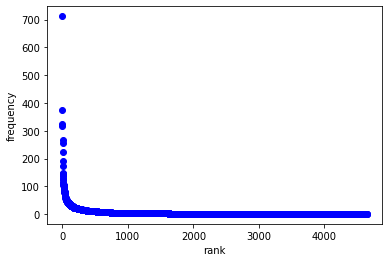

In [468]:
rank=0
for k, v in sort_dict_SW:
    rank+=1
    plt.plot(rank, words_dict_SW[k], 'bo')
plt.xlabel('rank')
plt.ylabel('frequency')
plt.show()

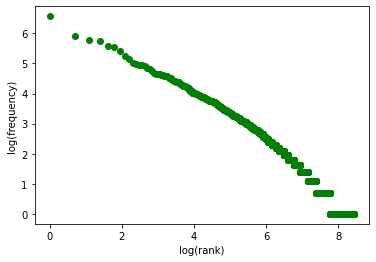

In [469]:
rank=0
for k, v in sort_dict_SW:
    rank+=1
    plt.plot(math.log(rank), math.log(v), 'go')
plt.xlabel('log(rank)')
plt.ylabel('log(frequency)')
plt.show()

In [470]:
len(text_del_SW3)

25696

In [471]:
text_freq = []
for t in text_del_SW3:
    temp=list(t)
    word_n = words_dict_SW[t[1]]
    temp.insert(4, word_n)
    text_freq.append(temp)

In [472]:
text_freq[:10]

[['Sentence: 1', '대체적', 'NNG', '100', 12],
 ['Sentence: 1', '환경', 'NNG', '100', 99],
 ['Sentence: 1', '좋', 'VA', '100', 712],
 ['Sentence: 1', '부서', 'NNG', '100', 44],
 ['Sentence: 1', '따르', 'VV', '100', 59],
 ['Sentence: 1', '다르', 'VV', '100', 56],
 ['Sentence: 1', '업무량', 'NNG', '100', 28],
 ['Sentence: 1', '몰리', 'VV', '100', 5],
 ['Sentence: 1', '야근', 'NNG', '100', 52],
 ['Sentence: 1', '필요', 'NNG', '100', 32]]

In [473]:
# 빈도수 5개 이하 삭제
text_del_words = []
for t in text_freq:
    temp=list(t)
    if t[4]>5:
        text_del_words.append(temp)

In [474]:
len(text_del_words)

19116

In [475]:
sent_n = []
for i in range(len(text_del_words)):
    sent_n.append(re.sub(r'[^0-9]', '', text_del_words[i][0]))

In [476]:
X_text=[]
y_score=[]
sent=[]
for i in range(len(sent_n)-1):
    if (int(sent_n[i]) == int(sent_n[i+1])):
        sent.append(text_del_words[i][1])
    else:
        X_text.append(sent)
        y_score.append(text_del_words[i][3])        
        sent=[]

In [477]:
X_text[:10]

[['대체적', '환경', '좋', '부서', '따르', '다르', '업무량', '야근', '필요', '경우'],
 ['정년', '확실히', '보장', '아니', '다양', '프로그램', '운영'],
 ['대한민국', '산업', '소수', '관리', '전문', '소속', '대한민국', '명'],
 ['수평적',
  '분위기',
  '좋',
  '상사',
  '눈치',
  '많이',
  '안',
  '보고',
  '휴가',
  '내가',
  '열심히',
  '일하',
  '좋아하',
  '삶'],
 ['많', '강도', '높'],
 ['활동', '좋', '지원'],
 ['수행', '정책', '크'],
 ['서울', '다루', '커리어', '쌓'],
 ['자유', '분위기', '보수적', '않', '상당히', '느낌'],
 ['제대로', '지키', '전반적', '없이', '다만', '어', '디']]

In [478]:
y_score[:10]

['100', '100', '100', '100', '100', '100', '100', '100', '100', '100']

In [479]:
tokenizer = Tokenizer()
X_text_token = tokenizer.fit_on_texts(X_text)

In [480]:
X_text_token

In [481]:
print(len(tokenizer.word_index))
print(tokenizer.word_index)
# 빈도수가 높은 단어 순서대로 index 부여

875
{'좋': 1, '없': 2, '많': 3, '일하': 4, '않': 5, '분위기': 6, '다니': 7, '배우': 8, '다양': 9, '문화': 10, '복지': 11, '경험': 12, '잘': 13, '연봉': 14, '안': 15, '크': 16, '많이': 17, '받': 18, '대하': 19, '성장': 20, '아니': 21, '편하': 22, '환경': 23, '쌓': 24, '경력': 25, '급여': 26, '너무': 27, '높': 28, '자유': 29, '편': 30, '나쁘': 31, '안정적': 32, '발전': 33, '신입': 34, '매우': 35, '업계': 36, '계약': 37, '추천': 38, '공무원': 39, '시간': 40, '대우': 41, '조직': 42, '있음': 43, '그냥': 44, '힘들': 45, '1': 46, '체계': 47, '따르': 48, '본인': 49, '하지만': 50, '개인': 51, '보수적': 52, '강도': 53, '가능': 54, '위하': 55, '야근': 56, '자기': 57, '개발': 58, '금융': 59, '다르': 60, '워': 61, '괜찮': 62, '비하': 63, '최고': 64, '나': 65, '부서': 66, '없이': 67, '대표': 68, '보험': 69, '공기업': 70, '더': 71, '사무실': 72, '알': 73, '장점': 74, '커리어': 75, '이상': 76, '능력': 77, '하나': 78, '은행': 79, '오래': 80, '운영': 81, '낮': 82, '정규직': 83, '위치': 84, '정도': 85, '수평적': 86, '그렇': 87, '별로': 88, '월급': 89, '돈': 90, '무난': 91, '가능성': 92, '다른': 93, '바뀌': 94, '스트레스': 95, '회계': 96, '못하': 97, '보장': 98, '수준': 99, '입사': 100, '생활': 10

In [482]:
threshold = 3
total_cnt = len(tokenizer.word_index)
rare_cnt=0 # threshold 보다 적은 빈도의 단어 수 count
total_freq = 0
rare_freq = 0

for k, v in tokenizer.word_counts.items():
    total_freq = total_freq + v
    
    if(v < threshold):
        rare_cnt = rare_cnt + 1
        rare_freq = rare_freq + v

In [483]:
print(total_cnt)
print(rare_cnt)


875
3


In [484]:
vocab_size = total_cnt - rare_cnt + 1
print(vocab_size)

873


In [485]:
len(X_text)

2553

In [486]:
tokenizer = Tokenizer(vocab_size)
tokenizer.fit_on_texts(X_text)
X_text = tokenizer.texts_to_sequences(X_text)

X_train, X_test, y_train, y_test = train_test_split(X_text, y_score, test_size=0.3, random_state=111)

In [487]:
X_text

[[361, 23, 1, 66, 48, 60, 144, 56, 238, 161],
 [202, 471, 98, 21, 9, 421, 81],
 [590, 272, 668, 116, 107, 525, 590, 253],
 [86, 6, 1, 254, 145, 17, 15, 381, 472, 526, 117, 4, 362, 203],
 [3, 53, 28],
 [591, 1, 102],
 [592, 334, 16],
 [187, 796, 75, 24],
 [29, 6, 52, 5, 473, 239],
 [335, 527, 108, 67, 109, 474, 528],
 [61, 188, 28, 14, 5, 422, 118, 593, 173, 363, 423],
 [22, 22, 63, 594],
 [314, 424, 134, 43, 204, 15, 797, 87, 382, 798],
 [205, 119, 120, 273, 17, 529, 88],
 [37, 38, 314, 103, 101, 12, 31],
 [2],
 [44, 91, 67, 202, 154, 7, 206],
 [39, 293, 47, 799, 383, 530, 54, 35, 425, 531, 274, 294, 669],
 [39, 103, 670, 94, 162],
 [118, 84, 240, 22, 22, 7],
 [75, 24, 7],
 [108, 134, 275, 101, 32, 23, 1],
 [1, 1, 23, 255, 295, 110, 207],
 [104, 595],
 [1, 256, 384, 49],
 [39, 336, 37, 4, 239, 50, 532],
 [4, 1, 296, 3, 222, 596],
 [26, 47, 2, 75],
 [276],
 [146, 315, 316, 46, 385, 94, 364, 144, 121, 316],
 [671, 6, 26, 475, 61, 188, 98],
 [800, 88, 135, 2, 189, 597, 317],
 [318, 18, 7,

In [488]:
len(X_train)

1787

In [489]:
y_test[:10]

['100', '100', '0', '0', '0', '100', '0', '100', '100', '0']

In [490]:
drop_train = [index for index, sentence in enumerate(X_train) if len(sentence) < 1]

In [491]:
drop_train # 비어 있는 샘플 확인

[50,
 589,
 706,
 773,
 890,
 952,
 968,
 980,
 1025,
 1261,
 1339,
 1405,
 1604,
 1717,
 1732]

In [492]:
for index in drop_train:
    del X_train[index]
    del y_train[index]

In [493]:
len(X_train)

1772

리뷰의 최대 길이 : 114
리뷰의 평균 길이 : 6.484198645598194


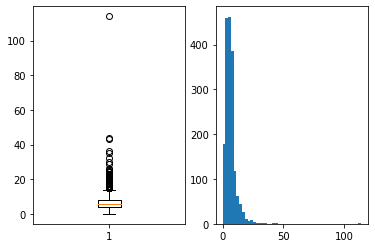

In [494]:
len_result = [len(s) for s in X_train]

print('리뷰의 최대 길이 : {}'.format(np.max(len_result)))
print('리뷰의 평균 길이 : {}'.format(np.mean(len_result)))

plt.subplot(1,2,1)
plt.boxplot(len_result)
plt.subplot(1,2,2)
plt.hist(len_result, bins=50)
plt.show()

In [495]:
max_len=25

In [496]:
def below_threshold_len(max_len, nested_list):
    count = 0
    for sentence in nested_list:
        if(len(sentence) <= max_len):
            count = count + 1
    print('전체 샘플 중 길이가 %s 이하인 샘플의 비율: %s'%(max_len, (count / len(nested_list))*100))

In [497]:
below_threshold_len(max_len, X_train)

전체 샘플 중 길이가 25 이하인 샘플의 비율: 99.37923250564334


In [498]:
unique_elements, counts_elements = np.unique(y_train, return_counts=True)
print("각 레이블에 대한 빈도수:")
print(np.asarray((unique_elements, counts_elements)))

각 레이블에 대한 빈도수:
[['0' '100']
 ['903' '869']]


In [499]:
word_to_index = tokenizer.word_index
index_to_word = {}
for key, value in word_to_index.items():
    index_to_word[value+3] = key

In [500]:
print('빈도수 상위 1등 단어 : {}'.format(index_to_word[4]))

빈도수 상위 1등 단어 : 좋


In [501]:
# (index 변환 전) X_train[0] 한국어 단어 표시
for index, token in enumerate(("<pad>", "<sos>", "<unk>")):
    index_to_word[index] = token

print(' '.join([index_to_word[index] for index in X_train[0]]))

퇴사 운영 마인드 대하 대하 일하


In [502]:
X_train = np.array(X_train)
y_train = np.array(y_train)
X_test = np.array(X_test)
y_test = np.array(y_test)

In [503]:
X_train = pad_sequences(X_train, maxlen=max_len)
X_test = pad_sequences(X_test, maxlen=max_len)

In [504]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(1772, 25)
(1772,)
(766, 25)
(766,)


In [505]:
# Naive bayes training
nb = MultinomialNB()
nb.fit(X_train, y_train)
preds = nb.predict(X_test)
print(confusion_matrix(y_test, preds))
print('\n')
print(classification_report(y_test, preds))

[[186 202]
 [181 197]]


              precision    recall  f1-score   support

           0       0.51      0.48      0.49       388
         100       0.49      0.52      0.51       378

    accuracy                           0.50       766
   macro avg       0.50      0.50      0.50       766
weighted avg       0.50      0.50      0.50       766



In [506]:
# Logistic Regression training

logreg = LogisticRegression(solver='liblinear')
logreg.fit(X_train, y_train)
# Logistic Regression prediction
y_pred_logreg = logreg.predict(X_test)
print(classification_report(y_test, y_pred_logreg))

              precision    recall  f1-score   support

           0       0.53      0.55      0.54       388
         100       0.52      0.51      0.52       378

    accuracy                           0.53       766
   macro avg       0.53      0.53      0.53       766
weighted avg       0.53      0.53      0.53       766



In [507]:
# ANN
ANN = MLPClassifier(solver='lbfgs', alpha=1, hidden_layer_sizes=(20, 2), random_state=4)
ANN.fit(X_train, y_train)
y_pred_ANN = ANN.predict(X_test)
print(classification_report(y_test, y_pred_ANN))

              precision    recall  f1-score   support

           0       0.51      1.00      0.67       388
         100       0.00      0.00      0.00       378

    accuracy                           0.51       766
   macro avg       0.25      0.50      0.34       766
weighted avg       0.26      0.51      0.34       766



c:\users\sj\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [508]:
# k-Nearest Neighbor
knn  = KNeighborsClassifier(n_neighbors = 2)
knn.fit(X_train, y_train)
y_pred_knn = knn.predict(X_test)
print(classification_report(y_test, y_pred_knn))

              precision    recall  f1-score   support

           0       0.51      0.78      0.62       388
         100       0.52      0.24      0.33       378

    accuracy                           0.51       766
   macro avg       0.52      0.51      0.47       766
weighted avg       0.52      0.51      0.48       766



In [509]:
# Decision Tree
decision_tree = DecisionTreeClassifier()
decision_tree.fit(X_train, y_train)
y_pred_DT = decision_tree.predict(X_test)
print(classification_report(y_test, y_pred_DT))

              precision    recall  f1-score   support

           0       0.50      0.49      0.50       388
         100       0.49      0.51      0.50       378

    accuracy                           0.50       766
   macro avg       0.50      0.50      0.50       766
weighted avg       0.50      0.50      0.50       766



In [ ]:
# SVM
svc = SVC(gamma='scale', kernel='linear')
svc.fit(X_train, y_train)
y_pred_svc = svc.predict(X_test)
print(classification_report(y_test, y_pred_svc))
